In [1]:
import numpy as np
import matplotlib.pyplot as plt
import astropy.visualization as vis
from astropy.cosmology import LambdaCDM
import matplotlib as mpl
from MAS_library import MASL
import base_for_images as bfi

params = {'legend.fontsize': 7,
          'legend.handlelength': 2}
mpl.rcParams['figure.dpi'] = 550
mpl.rcParams['font.family'] = 'serif'
plt.rcParams.update(params)


# FULL SIM

In [22]:
zmin, zmax = 100, 105

In [54]:
basefolder = '/home/ayuba/scratch/'
sim = 'm25s7'
om0 = bfi.sims[sim][0]
s8 = bfi.sims[sim][1]
cmp = 'cubehelix'
smin = 0 
grid = 2048
vm = "3.2"
mlim = float('1e14')

In [55]:
cosmol = LambdaCDM(H0=100 * 0.7, Om0=om0, Ode0=1 - om0)

In [56]:
BoxSize=500
s = 110

z, pos = bfi.read_pos(basefolder, sim, s)
age = cosmol.age(z).value
inds = np.where((pos[:,2]>=zmin) & (pos[:,2]<=zmax))[0]

npos = pos[inds]
npos[:,2]-= zmin
ngroups=0

density_field = np.zeros((grid,grid), dtype=np.float32)
MASL.MA(npos[:,0:2].astype(np.float32), density_field, BoxSize, MAS='CIC')
density_field /= np.mean(density_field)

3.2413566 3.2


(-0.5, 2047.5, -0.5, 2047.5)

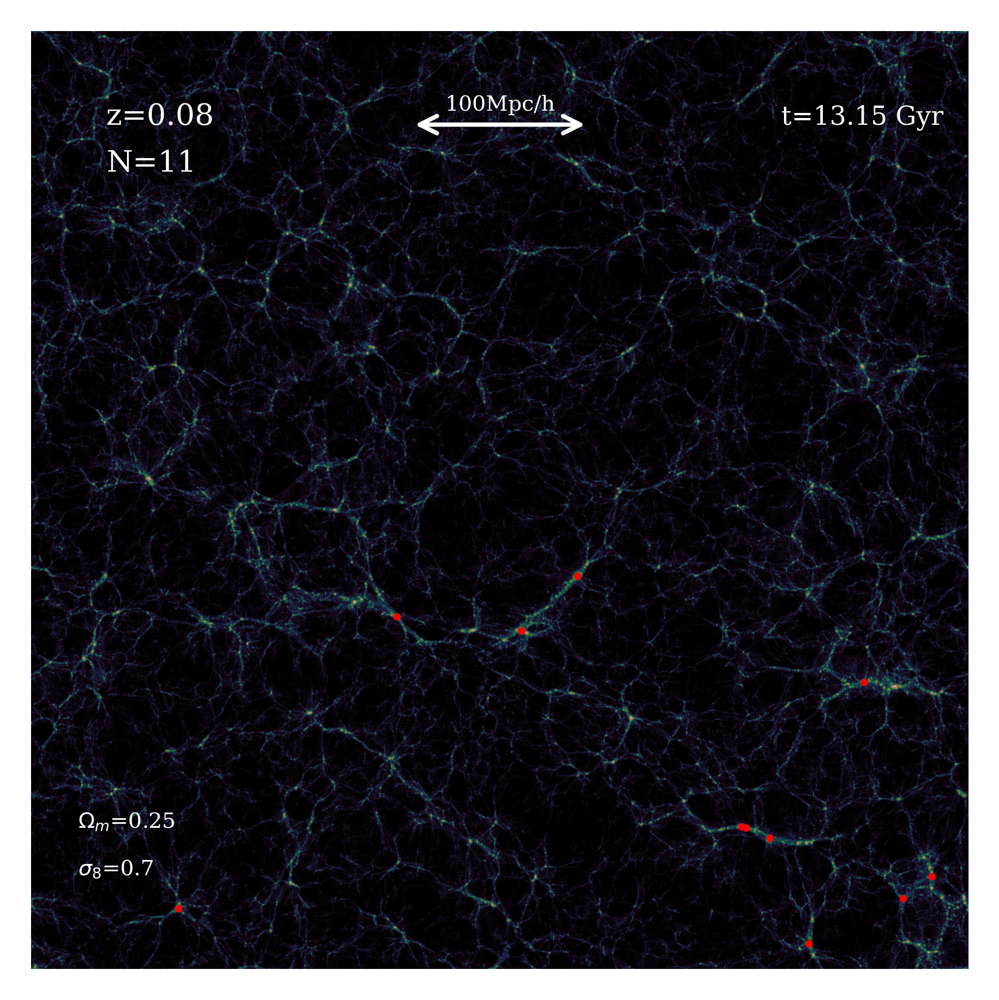

In [57]:
fig = plt.figure()

#zr = np.arcsinh(density_field.T - 1)

zr = np.log10(density_field.T+1)

if vm == 'variable':
    vmax = 4 + s*(2.1/59)
else:
    vmax = float(vm)
print(np.max(zr), vmax)

plt.imshow(zr, interpolation='bicubic', cmap=cmp, vmin=0.05, vmax=3.2, origin='lower')
if s>17:
    hal_x, hal_y, hal_z = bfi.read_hal_pos(basefolder, sim , s, mlim)
    nhal_x = hal_x[(hal_z>zmin)*(hal_z<zmax)]
    nhal_y = hal_y[(hal_z>zmin)*(hal_z<zmax)]
    ngroups = len(nhal_x)
    plt.scatter((nhal_x/BoxSize)*grid, (nhal_y/BoxSize)*grid, s=5*mlim/1e15, c='r', marker='o')

plt.text(0.08*grid, 0.9*grid, 'z={:1.2f}'.format(z), color='white', size=7) 
plt.text(0.8*grid, 0.9*grid, 't={:1.2f} Gyr'.format(age), color='white', size=6)
plt.text(0.08*grid, 0.85*grid, 'N={:1.0f}'.format(ngroups), color='white', size=7) 
plt.text(0.05*grid, 0.15*grid, r'$\Omega_m$={:1.2f}'.format(om0), color='white', size=5)
plt.text(0.05*grid, 0.1*grid, r'$\sigma_8$={:1.1f}'.format(s8), color='white', size=5)

plt.annotate("", xy=(0.4*grid, 0.9*grid), xytext=(0.6*grid, 0.9*grid), arrowprops=dict(arrowstyle='<->', linewidth=1, color='white'))
plt.text(0.5*grid, 0.915*grid, "100Mpc/h", ha='center', color='white', size=5)

plt.axis('off')

#plt.close(fig)

(-0.5, 2047.5, -0.5, 2047.5)

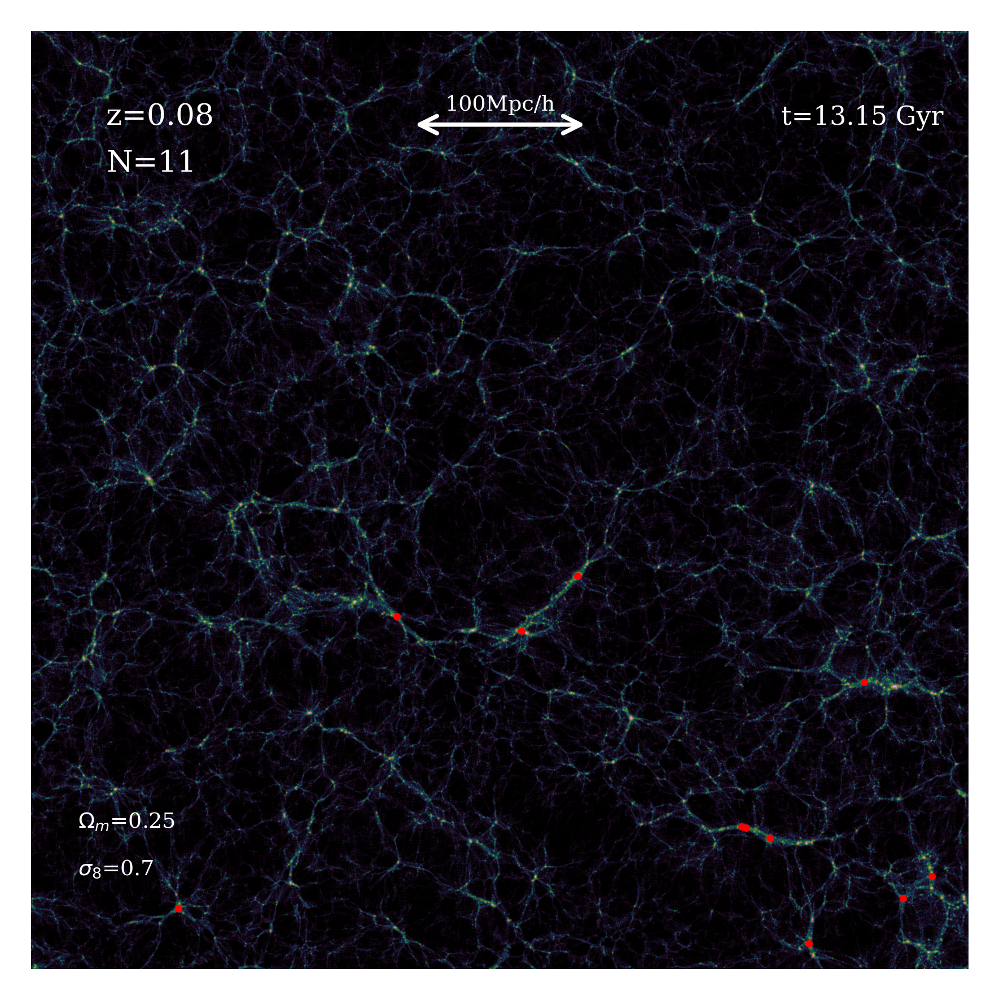

In [58]:
plt.imshow(zr, interpolation='bicubic', cmap=cmp, vmin=0.05, vmax=3.2, origin='lower')
if s>17:
    hal_x, hal_y, hal_z = bfi.read_hal_pos(basefolder, sim , s, mlim)
    nhal_x = hal_x[(hal_z>zmin)*(hal_z<zmax)]
    nhal_y = hal_y[(hal_z>zmin)*(hal_z<zmax)]
    ngroups = len(nhal_x)
    plt.scatter((nhal_x/BoxSize)*grid, (nhal_y/BoxSize)*grid, s=5*mlim/1e15, c='r', marker='o')

plt.text(0.08*grid, 0.9*grid, 'z={:1.2f}'.format(z), color='white', size=7) 
plt.text(0.8*grid, 0.9*grid, 't={:1.2f} Gyr'.format(age), color='white', size=6)
plt.text(0.08*grid, 0.85*grid, 'N={:1.0f}'.format(ngroups), color='white', size=7) 
plt.text(0.05*grid, 0.15*grid, r'$\Omega_m$={:1.2f}'.format(om0), color='white', size=5)
plt.text(0.05*grid, 0.1*grid, r'$\sigma_8$={:1.1f}'.format(s8), color='white', size=5)

plt.annotate("", xy=(0.4*grid, 0.9*grid), xytext=(0.6*grid, 0.9*grid), arrowprops=dict(arrowstyle='<->', linewidth=1, color='white'))
plt.text(0.5*grid, 0.915*grid, "100Mpc/h", ha='center', color='white', size=5)

plt.axis('off')

(-0.5, 4047.5, -0.5, 4047.5)

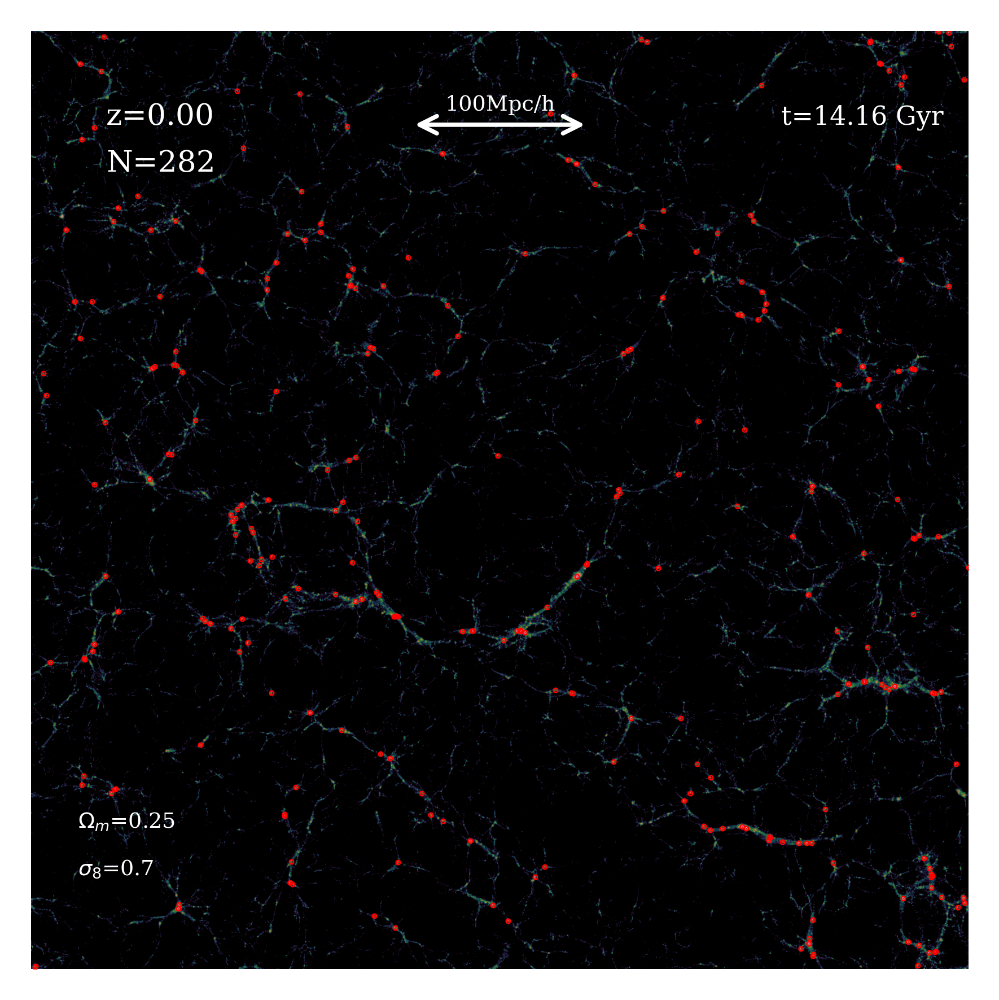

In [36]:
plt.imshow(zr, interpolation='bicubic', cmap=cmp, vmin=0.05, vmax=vmax, origin='lower')
if s>17:
    hal_x, hal_y, hal_z = bfi.read_hal_pos(basefolder, sim , s, mlim)
    nhal_x = hal_x[(hal_z>zmin)*(hal_z<zmax)]
    nhal_y = hal_y[(hal_z>zmin)*(hal_z<zmax)]
    ngroups = len(nhal_x)
    plt.scatter((nhal_x/BoxSize)*grid, (nhal_y/BoxSize)*grid, s=5*mlim/1e15, c='r', marker='o')

plt.text(0.08*grid, 0.9*grid, 'z={:1.2f}'.format(z), color='white', size=7) 
plt.text(0.8*grid, 0.9*grid, 't={:1.2f} Gyr'.format(age), color='white', size=6)
plt.text(0.08*grid, 0.85*grid, 'N={:1.0f}'.format(ngroups), color='white', size=7) 
plt.text(0.05*grid, 0.15*grid, r'$\Omega_m$={:1.2f}'.format(om0), color='white', size=5)
plt.text(0.05*grid, 0.1*grid, r'$\sigma_8$={:1.1f}'.format(s8), color='white', size=5)

plt.annotate("", xy=(0.4*grid, 0.9*grid), xytext=(0.6*grid, 0.9*grid), arrowprops=dict(arrowstyle='<->', linewidth=1, color='white'))
plt.text(0.5*grid, 0.915*grid, "100Mpc/h", ha='center', color='white', size=5)

plt.axis('off')

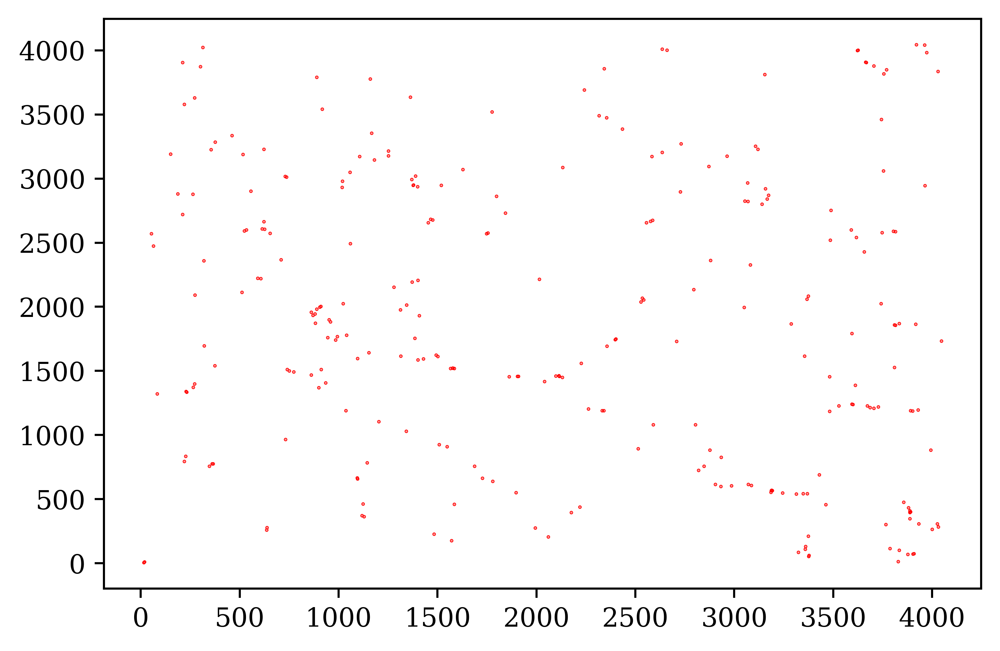

In [35]:
plt.scatter((nhal_x/BoxSize)*grid, (nhal_y/BoxSize)*grid, s=10*mlim/1e15, c='r', marker='o')

# ZOOM 

In [27]:
from scipy.ndimage import gaussian_filter
import scipy.ndimage as ndimage
from scipy.interpolate import RegularGridInterpolator

def smooth_function(f, sigma):
    smoothed = gaussian_filter(f, sigma=sigma)
    return smoothed

In [2]:
from astropy.cosmology import LambdaCDM

BoxSize=50
mlim = 1e13
zmin, zmax = 100, 150
sim = 'm25s7'
om0 = bfi.sims[sim][0]
s8 = bfi.sims[sim][1]
cmp = 'cubehelix'
cosmol = LambdaCDM(H0=100 * 0.7, Om0=om0, Ode0=1 - om0)
xmin, xmax = 50, 100
ymin, ymax = 50, 100

In [3]:
s = 53

In [58]:
z, pos = bfi.read_pos(basefolder, sim, s)

inds = np.where((pos[:,2]>=zmin) & (pos[:,2]<=zmax) & (pos[:,1]>=ymin) & (pos[:,1]<=ymax) 
                                   & (pos[:,0]>=xmin) & (pos[:,0]<=xmax))[0]
npos = pos[inds]
npos[:,2]-= zmin

age = cosmol.age(z).value

In [59]:
k = 0
if s<50:
    grid = int(512 + (20+20*k)*s)
    sig = 2.01-0.04*s 
else:
    grid = int(1512 + k*1000 + (10+10*k)*(s-50))
    sig = 0.01
print(grid, sig)

1542 0.01


In [60]:
density_field = np.zeros((grid,grid), dtype=np.float32)
    
MASL.MA(npos[:,0:2].astype(np.float32), density_field, BoxSize, MAS='CIC')

density_field /= np.mean(density_field)

zr = density_field.T -1 

sfix = smooth_function(np.arcsinh(zr), sig)    
svar = smooth_function(zr, sig)
print(np.max(sfix))

6.551191


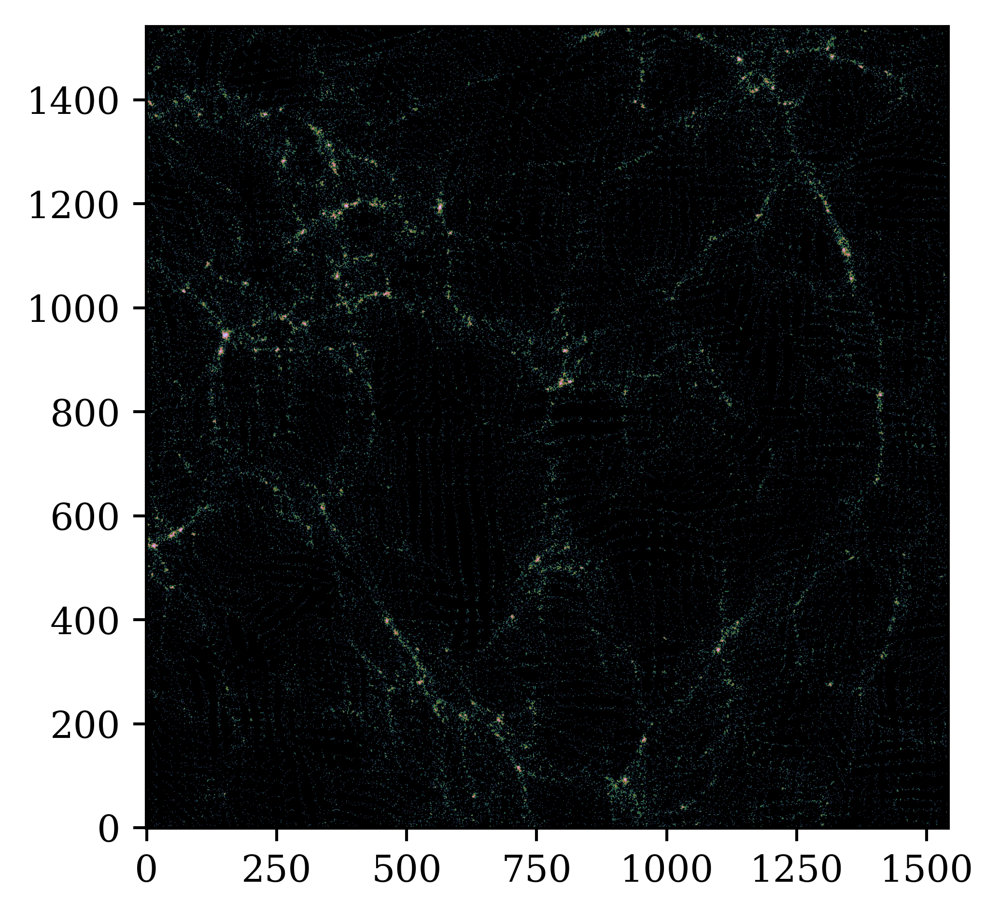

In [62]:
fig1 = plt.figure()
plt.imshow(sfix, interpolation='bicubic', vmin=0.02,  vmax=7.2, cmap=cmp, origin='lower')


0.03


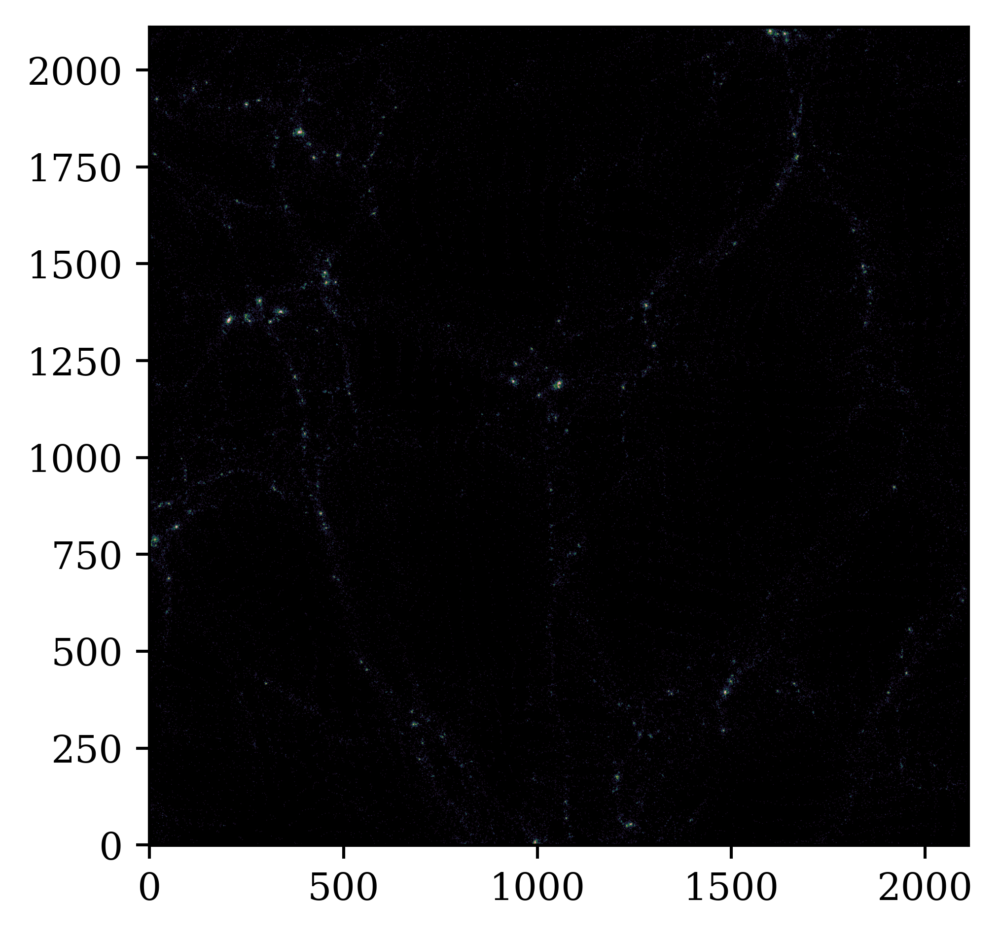

In [54]:
asinh_a = 0.03
print(asinh_a)
norm = vis.simple_norm(svar, 'asinh', asinh_a=asinh_a, min_percent=10, max_percent=100)
fig2 = plt.figure()
plt.imshow(svar, interpolation='gaussian', norm=norm, cmap=cmp, origin='lower')

### NEW ZOOM, FIXED GRID

In [3]:
BoxSize=50
mlim = 1e13
zmin, zmax = 100, 150 
sim = "m25s7"
om0 = bfi.sims[sim][0]
s8 = bfi.sims[sim][1]
cmp = 'cubehelix'
smin = int(40)
cosmol = LambdaCDM(H0=100 * 0.7, Om0=om0, Ode0=1 - om0)
xmin, xmax = 50, 100
ymin, ymax = 50, 100

In [8]:
s = 40 

In [9]:
z, pos = bfi.read_pos(basefolder, sim, s)

inds = np.where((pos[:,2]>=zmin) & (pos[:,2]<=zmax) & (pos[:,1]>=ymin) & (pos[:,1]<=ymax) 
                                   & (pos[:,0]>=xmin) & (pos[:,0]<=xmax))[0]
npos = pos[inds]
npos[:,2]-= zmin

age = cosmol.age(z).value

In [10]:
grid = 2024

density_field = np.zeros((grid,grid), dtype=np.float32)
    
MASL.MA(npos[:,0:2].astype(np.float32), density_field, BoxSize, MAS='CIC')

density_field /= np.mean(density_field)

zr = np.arcsinh(density_field.T -1) 

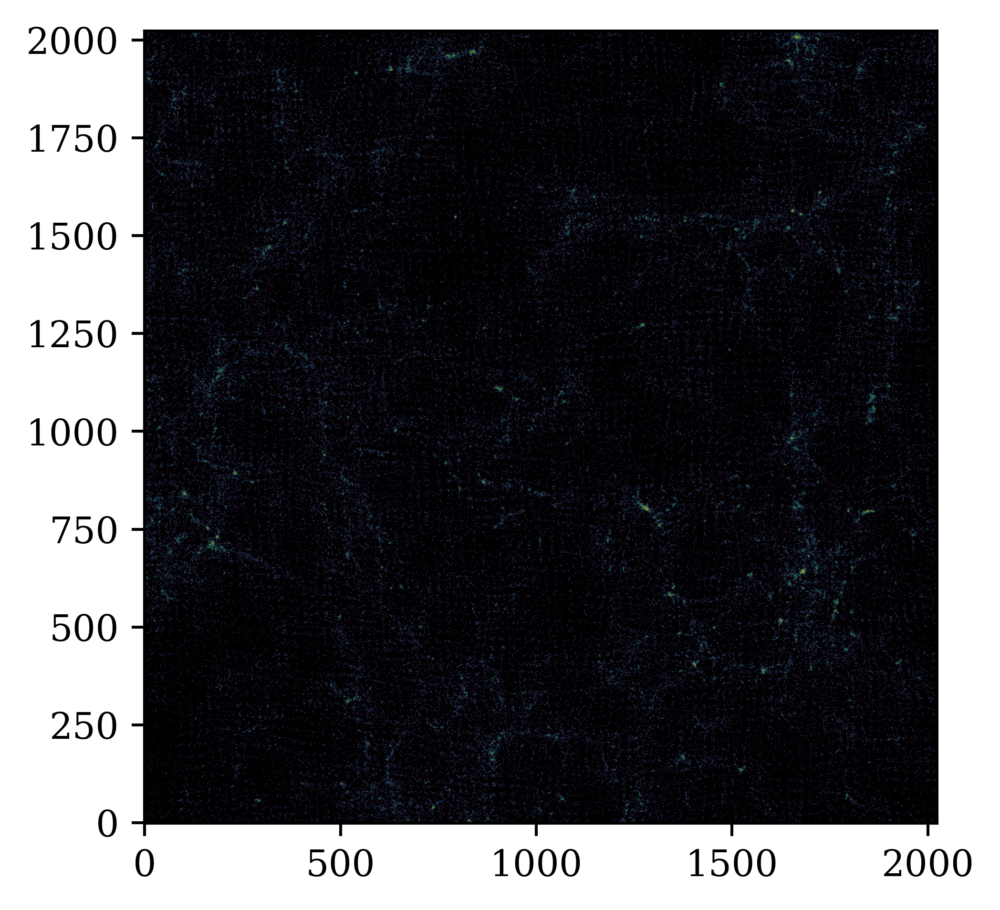

In [14]:
fig1 = plt.figure()
plt.imshow(zr, interpolation='bicubic', vmin=0.1, vmax=6.46, cmap=cmp, origin='lower')